In [38]:
import csv
import json
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
import matplotlib as mlt
import matplotlib.image as mpimg
import matplotlib.animation as animation

In [66]:
# Read the event log into an array of dictionaries
events = pd.read_csv('0021500495.csv', index_col=None)
events

,GAME_ID,EVENTNUM,EVENTMSGTYPE,EVENTMSGACTIONTYPE,PERIOD,WCTIMESTRING,PCTIMESTRING,HOMEDESCRIPTION,NEUTRALDESCRIPTION,VISITORDESCRIPTION,...,PLAYER2_TEAM_CITY,PLAYER2_TEAM_NICKNAME,PLAYER2_TEAM_ABBREVIATION,PERSON3TYPE,PLAYER3_ID,PLAYER3_NAME,PLAYER3_TEAM_ID,PLAYER3_TEAM_CITY,PLAYER3_TEAM_NICKNAME,PLAYER3_TEAM_ABBREVIATION
0,21500495,0,12,0,1,3:11 PM,12:00,NaN,NaN,NaN,...,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN
1,21500495,1,10,0,1,3:11 PM,12:00,Jump Ball Johnson vs. Lopez: Tip to Young,NaN,NaN,...,Brooklyn,Nets,BKN,5,201152,Thaddeus Young,1.610613e+09,Brooklyn,Nets,BKN
2,21500495,2,1,44,1,3:11 PM,11:42,NaN,NaN,Young 1' Reverse Layup (2 PTS) (Johnson 1 AST),...,Brooklyn,Nets,BKN,0,0,NaN,NaN,NaN,NaN,NaN
3,21500495,3,5,1,1,3:11 PM,11:32,Sullinger Bad Pass Turnover (P1.T1),NaN,Lopez STEAL (1 STL),...,Brooklyn,Nets,BKN,0,0,NaN,NaN,NaN,NaN,NaN
4,21500495,4,2,1,1,3:12 PM,11:14,NaN,NaN,MISS Young 21' Jump Shot,...,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
497,21500495,593,8,0,4,5:30 PM,0:11,NaN,NaN,SUB: Ellington FOR Sloan,...,Brooklyn,Nets,BKN,0,0,NaN,NaN,NaN,NaN,NaN
498,21500495,594,5,1,4,5:31 PM,0:10,Smart STEAL (3 STL),NaN,Young Bad Pass Turnover (P1.T14),...,Boston,Celtics,BOS,0,0,NaN,NaN,NaN,NaN,NaN
499,21500495,595,2,1,4,5:31 PM,0:02,MISS Jerebko 3PT Jump Shot,NaN,NaN,...,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN
500,21500495,596,4,0,4,5:31 PM,0:01,Smart REBOUND (Off:3 Def:0),NaN,NaN,...,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN


In [71]:
data['events'][8].keys()

dict_keys(['eventId', 'visitor', 'home', 'moments'])

In [67]:
# Read in the SportVU tracking data and convert to dictionary
sportvu = []
with open('0021500495.json', mode='r') as sportvu_json:  
    sportvu = json.load(sportvu_json)
    data = pd.DataFrame.from_dict(sportvu)
data.head()

,gameid,gamedate,events
0,0021500495,2016-01-02,"{'eventId': '1', 'visitor': {'name': 'Brooklyn..."
1,0021500495,2016-01-02,"{'eventId': '2', 'visitor': {'name': 'Brooklyn..."
2,0021500495,2016-01-02,"{'eventId': '3', 'visitor': {'name': 'Brooklyn..."
3,0021500495,2016-01-02,"{'eventId': '4', 'visitor': {'name': 'Brooklyn..."
4,0021500495,2016-01-02,"{'eventId': '5', 'visitor': {'name': 'Brooklyn..."


In [41]:
player_fields = data['events'][0]['home']['players'][0].keys()
home_players = pd.DataFrame(data=[i for i in data['events'][0]['home']['players']], columns=player_fields)
away_players = pd.DataFrame(data=[i for i in data['events'][0]['visitor']['players']], columns=player_fields)
players = pd.merge(home_players, away_players, how='outer')
jerseydict = dict(zip(players.playerid.values, players.jersey.values))
players

,lastname,firstname,playerid,jersey,position
0,Bradley,Avery,202340,0,G
1,Thomas,Isaiah,202738,4,G
2,Sullinger,Jared,203096,7,C-F
3,Jerebko,Jonas,201973,8,F
4,Turner,Evan,202323,11,G-F
5,Young,James,203923,13,G-F
6,Smart,Marcus,203935,36,G
7,Olynyk,Kelly,203482,41,C-F
8,Lee,David,101135,42,F-C
9,Zeller,Tyler,203092,44,C-F


In [42]:
# thanks to @dvatterott for the open source code!

# Animation function / loop
def draw_court(axis):
    img = mpimg.imread('./nba_court_T.png')
    plt.imshow(img,extent=axis, zorder=0)

def animate(n): #matplotlib's animation function loops through a function n times that draws a different frame on each iteration
    for i,ii in enumerate(player_xy[n]): #loop through all the players
        player_circ[i].center = (ii[1], ii[2]) #change each players xy position
        player_text[i].set_text(str(jerseydict[ii[0]])) #draw the text for each player. 
        player_text[i].set_x(ii[1]) #set the text x position
        player_text[i].set_y(ii[2]) #set text y position
    ball_circ.center = (ball_xy[n,0],ball_xy[n,1]) #change ball xy position
    ball_circ.radius = 1.1 #i could change the size of the ball according to its height, but chose to keep this constant
    return tuple(player_text) + tuple(player_circ) + (ball_circ,)

def init(): #this is what matplotlib's animation will create before drawing the first frame. 
    for i in range(10): #set up players
        player_text[i].set_text('')
        ax.add_patch(player_circ[i])
    ax.add_patch(ball_circ) #create ball
    ax.axis('off') #turn off axis
    dx = 5
    plt.xlim([0-dx,100+dx]) #set axis
    plt.ylim([0-dx,50+dx])  
    return tuple(player_text) + tuple(player_circ) + (ball_circ,)

In [89]:
event_num = 52
print(data['events'][event_num]['moments'])
ball_xy = np.array([x[5][0][2:5] for x in data['events'][event_num]['moments']]) #create matrix of ball data
player_xy = np.array([np.array(x[5][1:])[:,1:4] for x in data['events'][event_num]['moments']]) #create matrix of player data

[[1, 1451766241019, 377.6, 22.27, None, [[-1, -1, 29.10352, 16.33869, 1.33783], [1610612738, 101161, 45.68174, 27.12383, 0.0], [1610612738, 202738, 56.5068, 20.84034, 0.0], [1610612738, 202340, 57.84028, 39.29791, 0.0], [1610612738, 203109, 62.56857, 11.7841, 0.0], [1610612738, 203096, 70.07854, 21.76939, 0.0], [1610612751, 2207, 42.28554, 5.59401, 0.0], [1610612751, 101127, 27.02204, 17.51399, 0.0], [1610612751, 201152, 17.38236, 32.59221, 0.0], [1610612751, 201572, 65.15969, 20.85559, 0.0], [1610612751, 202711, 57.12708, 46.66751, 0.0]]], [1, 1451766241058, 377.56, 22.23, None, [[-1, -1, 29.81562, 16.57244, 0.65875], [1610612738, 101161, 45.9978, 27.1601, 0.0], [1610612738, 202738, 56.70578, 20.78112, 0.0], [1610612738, 202340, 58.33412, 39.35408, 0.0], [1610612738, 203109, 62.85018, 11.71879, 0.0], [1610612738, 203096, 70.25794, 21.6795, 0.0], [1610612751, 2207, 42.78755, 5.4785, 0.0], [1610612751, 101127, 27.44065, 17.4054, 0.0], [1610612751, 201152, 17.88358, 32.62223, 0.0], [1610

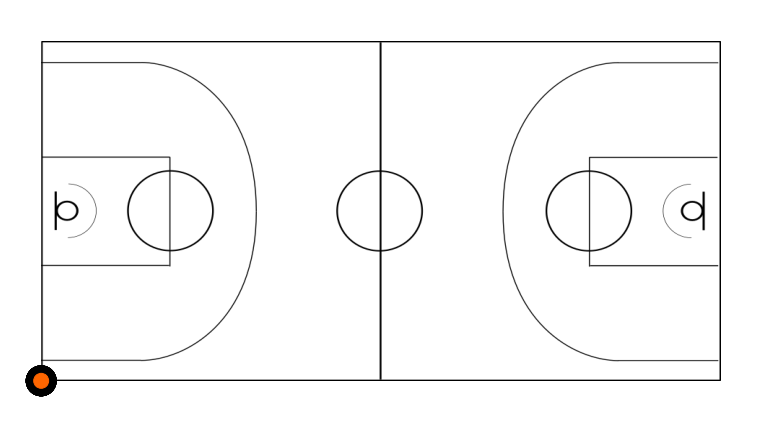

In [90]:
fig = plt.figure(figsize=(15,7.5)); #create figure object
ax = plt.gca(); #create axis object

draw_court([0,100,0,50]) #draw the court
player_text = [0] * 10 #create player text vector
player_circ = [0] * 10 #create player circle vector
ball_circ = plt.Circle((0,0), 1.1, color=[1, 0.4, 0]); #create circle object for bal
for i in range(10): #create circle object and text object for each player
    col=['w','k'] if i<5 else ['k','w'] #color scheme
    player_circ[i] = plt.Circle((0,0), 2.2, facecolor=col[0],edgecolor='k'); #player circle
    player_text[i] = ax.text(0,0,'',color=col[1],ha='center',va='center'); #player jersey # (text)

ani = animation.FuncAnimation(fig, animate, frames=np.arange(0,np.size(ball_xy,0)), init_func=init, blit=True, interval=5, repeat=False,\
                             save_count=0); #function for making video


In [96]:
matplotlib.rcParams['animation.embed_limit'] = 400000000
from IPython.display import HTML

HTML(ani.to_jshtml())